## Start

## Projet de classifcation de cellules sanguignes

Le jeu de données se compose de 17,092 images de cellules individuelles et sans pathologies. 
Les images sont organisées en 8 groupes (dossiers)
- neutrophils
- eosinophils
- basophils
- lymphocytes
- monocytes
- immature granulocytes (promyelocytes, myelocytes, and metamyelocytes)
- erythroblasts
- platelets (or thrombocytes)

Les images sont de dimmensionsb 360 x 363 pixels

Le regroupement des images en différentes catégories a été réalisé par des experts en pathologies cliniques. Les cellules sont issues d'individus sans infections particulières, sans maladies hematologiques ou oncologiques et sans traitement pharmaceutique.

Les données ont été collectées durant 4 ans (de 2015 à 2019)

In [1]:
import os
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import numpy as np
import cv2
from collections import Counter
from glob import glob
import pandas as pd
from sklearn.decomposition import PCA
from scipy.spatial.distance import cosine
from scipy.spatial import distance
from scipy.stats import entropy
from skimage.feature import hog, local_binary_pattern
from sklearn.manifold import TSNE
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import datasets, models, transforms
from sklearn.utils.class_weight import compute_class_weight
from tqdm import tqdm
from torch.utils.data import Subset



## Prévisualisation des images : 


In [6]:
DATASET_PATH = "/Users/mariegilles/Downloads/PBC_dataset_normal_DIB"


In [52]:
classes

['.DS_Store',
 'basophil',
 'eosinophil',
 'erythroblast',
 'ig',
 'lymphocyte',
 'monocyte',
 'neutrophil',
 'platelet']

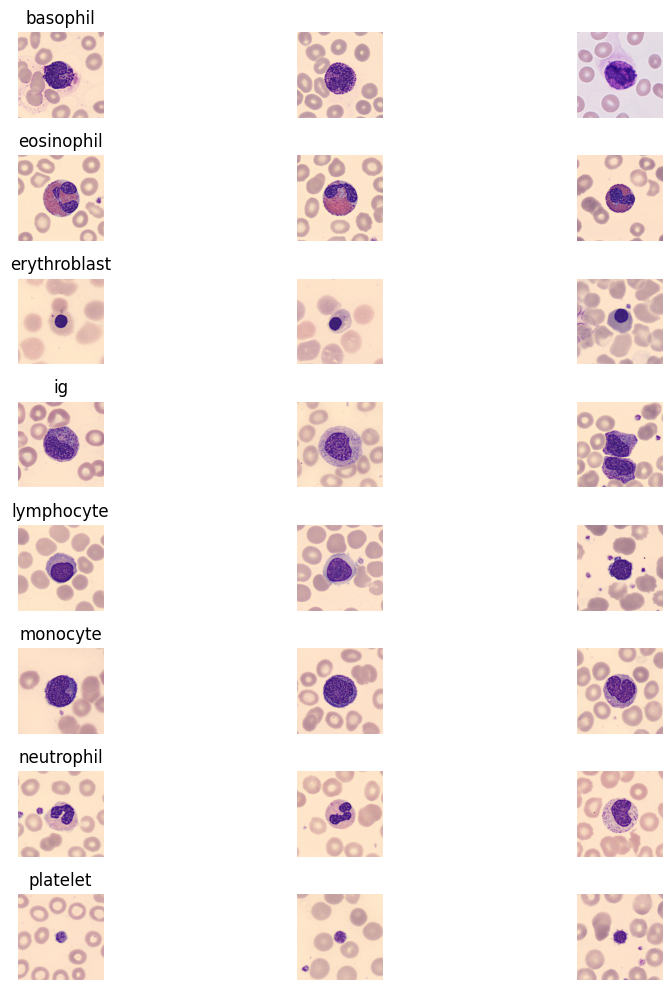

In [53]:
classes = sorted(os.listdir(DATASET_PATH))
classes.remove(".DS_Store")  # Remove system file if present
class_counts = {cls: len(os.listdir(os.path.join(DATASET_PATH, cls))) for cls in classes}

def plot_sample_images(dataset_path,classes, samples_per_class=3):
    fig, axes = plt.subplots(len(classes), samples_per_class, figsize=(10, 10))
    for i, cls in enumerate(classes):
        image_files = glob(os.path.join(dataset_path, cls, "*.jpg")) 
        for j in range(samples_per_class):
            img = cv2.imread(image_files[j])
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert from BGR to RGB
            axes[i, j].imshow(img)
            axes[i, j].axis("off")
            if j == 0:
                axes[i, j].set_title(cls)
    plt.tight_layout()
    plt.show()

plot_sample_images(DATASET_PATH, classes)

## Analyse de la distribution des données en fonction des différentes classes 

/var/folders/fh/00vk_bzj30q14z4hpjmm5jg80000gp/T/ipykernel_41012/2605491692.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(class_counts.keys()), y=list(class_counts.values()), palette="viridis")


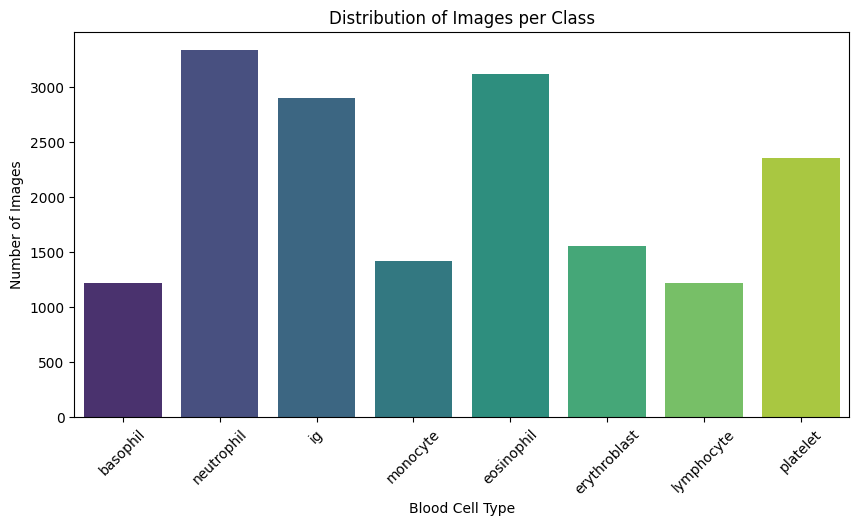

In [ ]:

class_counts = {}
for class_name in os.listdir(DATASET_PATH):
    class_folder = os.path.join(DATASET_PATH, class_name)
    if os.path.isdir(class_folder):
        class_counts[class_name] = len(os.listdir(class_folder))
plt.figure(figsize=(10, 5))
sns.barplot(x=list(class_counts.keys()), y=list(class_counts.values()), palette="viridis")
plt.xlabel("Blood Cell Type")
plt.ylabel("Number of Images")
plt.title("Distribution of Images per Class")
plt.xticks(rotation=45)
plt.show()

En visualisant la distribution, on remarque que les classes sont desiquilibrées. Une attention particulière devra être considérée lors de l'analyse des résulats du futur modèle. 
Nous aurons alors peut-être recours à un processus de réequilibrage des différenets classes 

## Analyse des couleurs des images 

In [ ]:
def extract_pixel_data(image_path):
    img = Image.open(image_path)
    
    if img.mode != 'RGB':
        img = img.convert('RGB')
    
    width, height = img.size
    
    pixels = list(img.getdata())
    
    pixel_list = []
    for index, pixel in enumerate(pixels):
        x = index % width
        y = index // width
        pixel_list.append({
            'x': x,
            'y': y,
            'red': pixel[0],
            'green': pixel[1],
            'blue': pixel[2]
        })
    
    df = pd.DataFrame(pixel_list)
    return df


In [ ]:
def visualize_cell_types_distribution(base_dir):
    """
    Creates a clear visualization of RGB distributions for each cell type with enhanced readability
    and normalized y-axis scale for better comparison across classes.
    
    Args:
        base_dir (str): Path to the main directory containing cell type subdirectories
    """
    cell_types = ['basophil', 'eosinophil', 'erythroblast', 'ig', 
                  'lymphocyte', 'monocyte', 'neutrophil', 'platelet']
    
    # Set the style parameters manually
    plt.rcParams['axes.grid'] = True
    plt.rcParams['grid.alpha'] = 0.3
    plt.rcParams['grid.color'] = '#cccccc'
    
    # Create subplot grid (4x2) with increased spacing
    fig, axes = plt.subplots(4, 2, figsize=(20, 24))
    
    # Enhanced main title with bold font and increased spacing
    fig.suptitle('Distribution RGB par type de cellule', 
                 fontsize=20, 
                 y=0.95, 
                 fontweight='bold')
    
    # Flatten the axes array for easier access
    axes = axes.ravel()
    
    # Enhanced color palette with better contrast and visual appeal
    colors = ['#FF6B6B', '#4ECB71', '#4A90E2']  # Softer red, green, blue
    labels = ['Rouge', 'Vert', 'Bleu']
    
    # Lists to store all density values for y-axis normalization
    all_densities = []
    
    # First pass: calculate KDE for all cell types to find global y-axis limits
    for idx, cell_type in enumerate(cell_types):
        cell_dir = os.path.join(base_dir, cell_type)
        if not os.path.exists(cell_dir):
            print(f"Dossier non trouvé pour {cell_type}")
            continue
            
        # Get RGB data
        all_red, all_green, all_blue = [], [], []
        image_files = glob(os.path.join(cell_dir, "*.jpg"))
        
        for img_path in image_files[:30]:
            df = extract_pixel_data(img_path)
            all_red.extend(df['red'])
            all_green.extend(df['green'])
            all_blue.extend(df['blue'])
        
        # Sampling for performance
        sample_size = min(10000, len(all_red))
        indices = np.random.choice(len(all_red), sample_size, replace=False)
        
        rgb_data = [
            np.array(all_red)[indices],
            np.array(all_green)[indices],
            np.array(all_blue)[indices]
        ]
        
        # Calculate KDE for each color channel
        for color_data in rgb_data:
            kde = sns.kdeplot(data=color_data, ax=axes[idx]).get_lines()[-1].get_data()
            all_densities.extend(kde[1])
    
    # Calculate global y-axis limits
    y_max = max(all_densities)
    
    # Second pass: plot with normalized y-axis
    for idx, cell_type in enumerate(cell_types):
        cell_dir = os.path.join(base_dir, cell_type)
        if not os.path.exists(cell_dir):
            continue
            
        # Clear previous plots
        axes[idx].clear()
        
        # Set background color
        axes[idx].set_facecolor('#f8f8f8')
        
        # Get RGB data again
        all_red, all_green, all_blue = [], [], []
        image_files = glob(os.path.join(cell_dir, "*.jpg"))
        
        for img_path in image_files[:30]:
            df = extract_pixel_data(img_path)
            all_red.extend(df['red'])
            all_green.extend(df['green'])
            all_blue.extend(df['blue'])
        
        sample_size = min(10000, len(all_red))
        indices = np.random.choice(len(all_red), sample_size, replace=False)
        
        rgb_data = [
            np.array(all_red)[indices],
            np.array(all_green)[indices],
            np.array(all_blue)[indices]
        ]
        
        # Plot with normalized y-axis
        for color_data, color, label in zip(rgb_data, colors, labels):
            sns.kdeplot(
                data=color_data,
                ax=axes[idx],
                color=color,
                label=label,
                fill=True,
                alpha=0.2,
                linewidth=2.5
            )
        
        # Set y-axis limits
        axes[idx].set_ylim(0, y_max * 1.1)  # Add 10% padding
        
        # Enhanced subplot formatting
        axes[idx].set_xlabel('Valeur de pixel', fontsize=12, fontweight='bold')
        axes[idx].set_ylabel('Densité', fontsize=12, fontweight='bold')
        axes[idx].tick_params(axis='both', labelsize=10)
        
        # Enhanced legend
        axes[idx].legend(fontsize=10, frameon=True, framealpha=0.9,
                        facecolor='white', edgecolor='gray')
        
        # Calculate statistics
        stats_text = (f'μ(R)={np.mean(rgb_data[0]):.1f}, '
                     f'μ(G)={np.mean(rgb_data[1]):.1f}, '
                     f'μ(B)={np.mean(rgb_data[2]):.1f}')
        
        # Enhanced title
        axes[idx].set_title(f'Type: {cell_type}\n{stats_text}',
                          fontsize=14,
                          fontweight='bold',
                          pad=20)
        
        axes[idx].margins(0.1)
        axes[idx].grid(True, alpha=0.3)
    
    # Adjust layout
    plt.tight_layout(h_pad=0.8, w_pad=0.8)
    fig.patch.set_facecolor('white')
    
    plt.show()

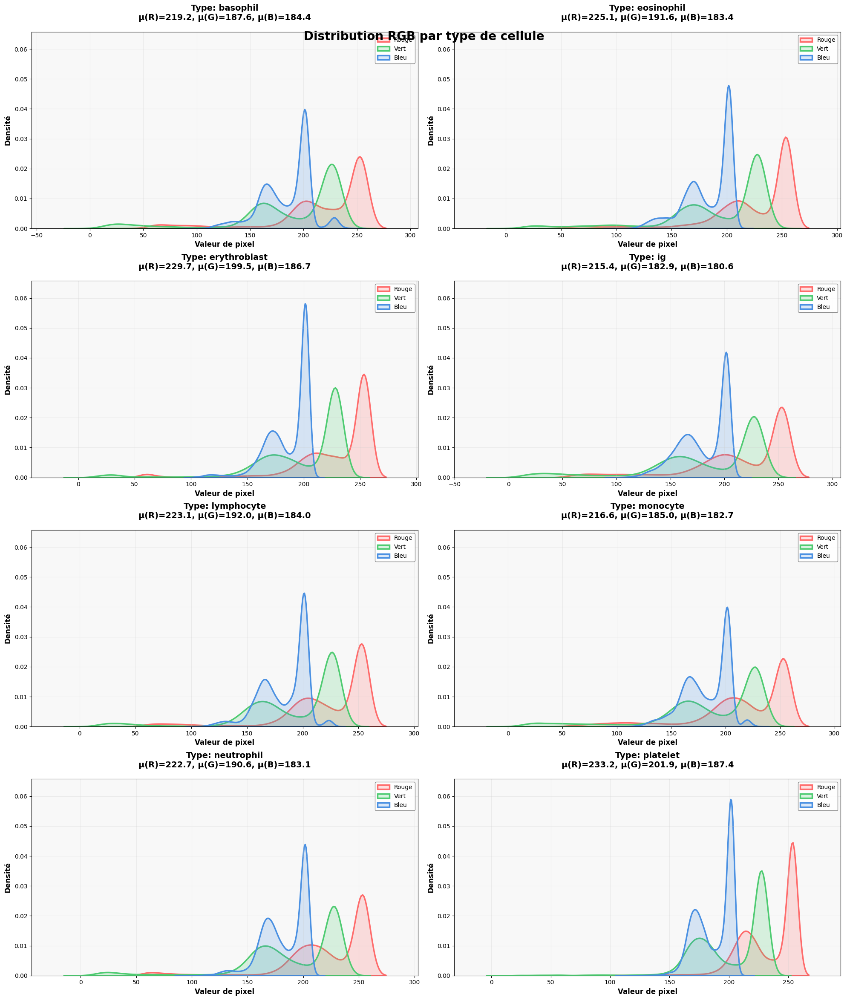

In [ ]:
visualize_cell_types_distribution(DATASET_PATH)

Ce graphique représente les histogrames des intensités des couleurs (rouges , vertes, et bleues) pour chaques classes. 
Dans la globalité, les histogrammes paraissent similaires tant ils se ressemblent. 
Les différents pics (d'abords un petit puis un grand) sont assez cohérents avec la prévisualisation que nous avions observé puisque la quantité d'intensité des pixels sont répartis majoritairement en deux parties (la cellule et le fond). 

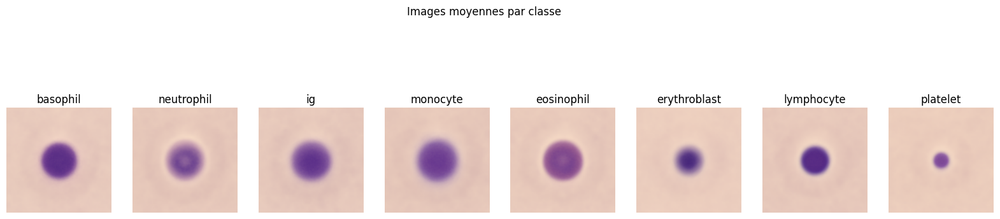

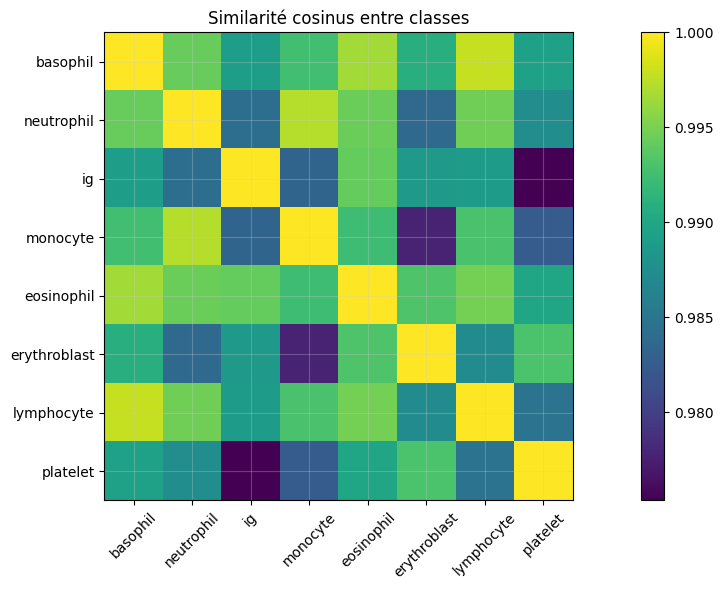

In [ ]:
IMG_SIZE = (224, 224) 

def load_images_by_class(dataset_path, img_size=(224,224), max_per_class=None):
    """Charge les images classées par dossier."""
    data = {}
    for class_name in os.listdir(dataset_path):
        class_path = os.path.join(dataset_path, class_name)
        if not os.path.isdir(class_path):
            continue
        images = []
        for i, fname in enumerate(os.listdir(class_path)):
            if max_per_class and i >= max_per_class:
                break
            img_path = os.path.join(class_path, fname)
            img = cv2.imread(img_path)
            if img is None:
                continue
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            img = cv2.resize(img, img_size)
            images.append(img)
        data[class_name] = np.array(images)
    return data


def compute_mean_image(images):
    """Calcule l'image moyenne d'une classe."""
    return np.mean(images, axis=0).astype(np.uint8)


def compute_mean_hist(images, bins=32):
    """Calcule l'histogramme moyen normalisé (RGB)."""
    hists = []
    for img in images:
        hist = []
        for i in range(3):  # R, G, B
            h = cv2.calcHist([img], [i], None, [bins], [0,256])
            h = cv2.normalize(h, h).flatten()
            hist.extend(h)
        hists.append(hist)
    return np.mean(hists, axis=0)


data = load_images_by_class(DATASET_PATH, IMG_SIZE, max_per_class=500)  # limite pour aller vite

mean_images = {}
mean_hists = {}
for cls, imgs in data.items():
    mean_images[cls] = compute_mean_image(imgs)
    mean_hists[cls] = compute_mean_hist(imgs)

fig, axes = plt.subplots(1, len(mean_images), figsize=(20,5))
for ax, (cls, img) in zip(axes, mean_images.items()):
    ax.imshow(img)
    ax.set_title(cls)
    ax.axis("off")
plt.suptitle("Images moyennes par classe")
plt.show()

classes = list(mean_hists.keys())

cosine_sim = np.zeros((len(classes), len(classes)))
js_div = np.zeros((len(classes), len(classes)))

for i, c1 in enumerate(classes):
    for j, c2 in enumerate(classes):
        cosine_sim[i,j] = 1 - cosine(mean_hists[c1], mean_hists[c2])

fig, ax = plt.subplots(1,1, figsize=(14,6))

im1 = ax.imshow(cosine_sim, cmap="viridis")
ax.set_xticks(range(len(classes)))
ax.set_yticks(range(len(classes)))
ax.set_xticklabels(classes, rotation=45)
ax.set_yticklabels(classes)
ax.set_title("Similarité cosinus entre classes")
plt.colorbar(im1, ax=ax)



plt.tight_layout()
plt.show()


Afin de comparer les classe entre elles, ces deux graphiques ont été générés afin de visualiser les écarts et leurs différences.
Le premier graphique représente les "images moyennes" en fonction de leur classes. Cela est rendu possible par le fait que l'intergralité des photos des cellules sont centrées et ainsi conserve un placement consistent des cellules. Techniquement parlant, ce graphique nous montre la valeur moyenne de chaque pixel par classe cce qui nous premet de comparer les classes pour lesquelles la cellule capturée comme par exemple son étalement, l'intensité de la couleur, et parfois même la variabilité de la forme (cellules avec un 'trou' au mileu)

Le deuxième graphique nous donne un inducateur chiffré de la distance entre chaque classes, on peut ainsi remarque que certaines cellules se 'ressemble' (e.g celles dont la similarité cosinus est proche de 1) comme par exemple le groupe basophil et lymphocyte ou au contraire celle donc la distance est plus éloignée (patelet et ig)


# PCA sur les nuances de gris 

### Création d'un dataset 

In [9]:
MAX_IMAGES = 100  # On fixe le nombre maximum d'image par classe que l'on souhaite selectionner
image_data = []
labels = []
for class_name in os.listdir(DATASET_PATH):
    class_path = os.path.join(DATASET_PATH, class_name)
    if os.path.isdir(class_path): 
        image_files = os.listdir(class_path)[:MAX_IMAGES] 
        for image_name in image_files:
            image_path = os.path.join(class_path, image_name)
       
            image = Image.open(image_path).convert("L") 
            image = np.array(image).flatten()  

            image_data.append(image)
            labels.append(class_name)
df = pd.DataFrame(image_data)
df.insert(0, "label", labels)  

print("Dataset shape:", df.shape)
df = df.dropna(axis=1, how='any')
print("Dataset shape:", df.shape)


Dataset shape: (800, 135055)
Dataset shape: (800, 129601)


Précision : la méthode dropna va ôter les colonnes qui contiennent au moins une valeur manquante (arg 'any'). 
Les images étant de tailles différentes, ce sont seulement les dernières colonnes qui sont impactées. 
Les colonnes qui ont été supprimées par la méthode ne contenait pas d'information cruciale à l'analyse puisqu'il s'agissait des pixel situé à l'extramité de l'image ainsi nous avons un dataset sans valeurs manquantes sans perte d'information

In [10]:
df.head()

,label,0,1,2,3,4,5,6,7,8,...,129590,129591,129592,129593,129594,129595,129596,129597,129598,129599
0,basophil,233,233,233,233,233,233,233,233,232,...,231,232,232,232,232,232,232,232,232,232
1,basophil,229,233,234,234,234,236,235,232,238,...,161,161,159,159,159,159,159,159,159,159
2,basophil,176,176,177,178,181,184,187,188,192,...,237,230,217,201,188,180,174,172,169,169
3,basophil,177,178,179,181,182,182,182,182,184,...,236,237,236,236,236,236,236,236,236,236
4,basophil,234,234,234,234,234,234,234,234,234,...,234,233,236,233,228,226,228,233,236,237


### On remplace les classes par des entiers 

In [11]:
label_mapping = {
    'basophil': 0,
    'neutrophil': 1,
    'ig': 2,
    'monocyte': 3,
    'eosinophil': 4,
    'erythroblast': 5,
    'lymphocyte': 6,
    'platelet': 7
}

df['label'] = df['label'].map(label_mapping)

### Séparation des données de la variable cible 

In [12]:
data = df.drop('label', axis = 1)
target  = df['label']

## PCA

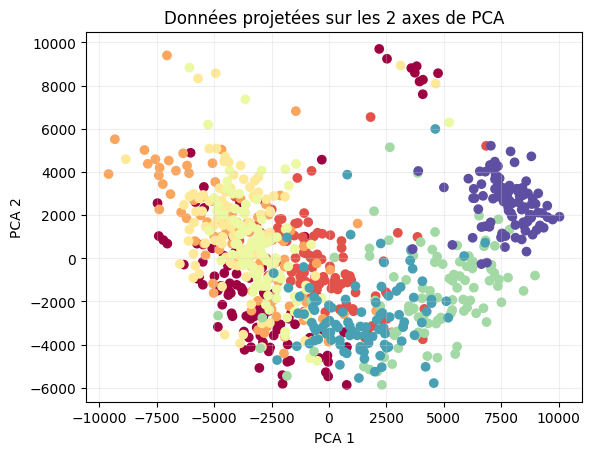

La part de variance expliquée est 0.9


In [13]:
pca = PCA(n_components = 0.9) # on fixe le seuil minimum de la part de la variance expliquée par le PCA
data_2D = pca.fit_transform(data)

fig = plt.figure()

ax = fig.add_subplot(111)
ax.scatter(data_2D[:, 0], data_2D[:, 1], c = target, cmap=plt.cm.Spectral)

ax.set_xlabel('PCA 1')
ax.set_ylabel('PCA 2')

ax.set_title("Données projetées sur les 2 axes de PCA")
plt.show();

print("La part de variance expliquée est", round(pca.explained_variance_ratio_.sum(),2))

In [14]:
print("Nombre de composantes retenues :", pca.n_components_)

Nombre de composantes retenues : 275


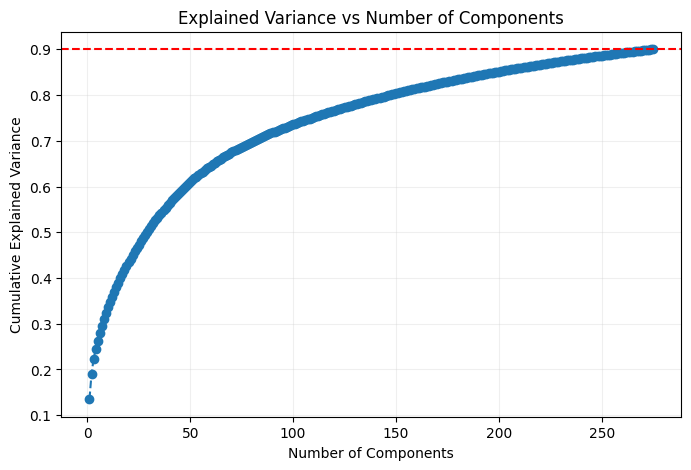

In [15]:
explained_variance_ratio = np.cumsum(pca.explained_variance_ratio_)

plt.figure(figsize=(8, 5))
plt.plot(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio, marker='o', linestyle='--')
plt.axhline(y=0.9, color='r', linestyle='--')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Explained Variance vs Number of Components')
plt.show()

## Résultats

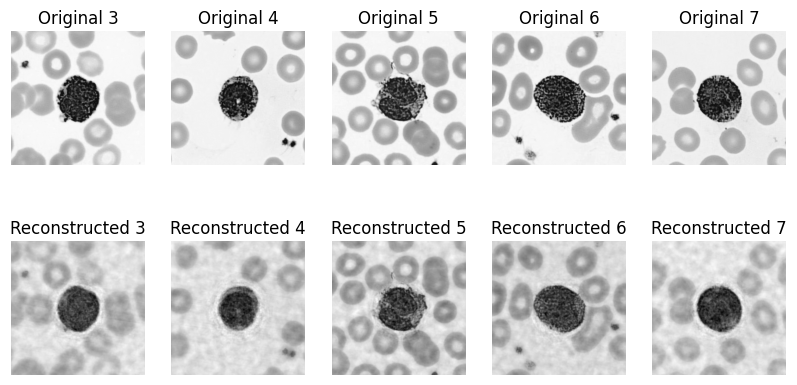

In [18]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

start_idx = 3
end_idx = 8
n_samples = end_idx - start_idx 
data_np = data.to_numpy()
reconstructed_data = pca.inverse_transform(data_2D)
IMAGE_HEIGHT = IMAGE_WIDTH = int(np.sqrt(data.shape[1]))

fig, axes = plt.subplots(2, n_samples, figsize=(10, 5))

for idx, i in enumerate(range(start_idx, end_idx)):  
    original_image = data_np[i].reshape(IMAGE_HEIGHT, IMAGE_WIDTH)  
    reconstructed_image = reconstructed_data[i].reshape(IMAGE_HEIGHT, IMAGE_WIDTH)  

    axes[0, idx].imshow(original_image, cmap='gray')  
    axes[0, idx].axis('off')
    axes[0, idx].set_title(f"Original {i}")

    axes[1, idx].imshow(reconstructed_image, cmap='gray') 
    axes[1, idx].axis('off')
    axes[1, idx].set_title(f"Reconstructed {i}")

plt.show()


In [ ]:
BATCH_SIZE = 32
IMG_SIZE = 224
EPOCHS = 20
LR = 1e-3
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

train_transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.RandomRotation(30),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])  # normalisation ImageNet
])

val_test_transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])
])


full_dataset = datasets.ImageFolder(DATASET_PATH, transform=train_transform)
class_names = full_dataset.classes


np.random.seed(42)
subset_indices = np.random.choice(len(full_dataset), 1400, replace=False)

subset_dataset = Subset(full_dataset, subset_indices)

n_train = int(0.7 * len(subset_dataset))
n_val = int(0.15 * len(subset_dataset))
n_test = len(subset_dataset) - n_train - n_val

train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(
    subset_dataset, [n_train, n_val, n_test],
    generator=torch.Generator().manual_seed(42)
)

# appliquer val/test transforms
val_dataset.dataset.transform = val_test_transform
test_dataset.dataset.transform = val_test_transform

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

# FOR CLASS IMBALANCE

labels = [y for _, y in train_dataset]
class_weights = compute_class_weight(
    class_weight="balanced",
    classes=np.arange(len(class_names)),
    y=labels
)
weights = torch.tensor(class_weights, dtype=torch.float).to(DEVICE)


model = models.resnet18(weights="IMAGENET1K_V1")
num_features = model.fc.in_features
model.fc = nn.Linear(num_features, len(class_names))
model = model.to(DEVICE)

criterion = nn.CrossEntropyLoss(weight=weights)
optimizer = optim.Adam(model.parameters(), lr=LR)


best_val_acc = 0.0
for epoch in range(EPOCHS):
    print(f"Epoch {epoch+1}/{EPOCHS}")
    # ---- TRAIN ----
    model.train()
    running_loss, running_corrects = 0.0, 0
    for inputs, labels in tqdm(train_loader):
        inputs, labels = inputs.to(DEVICE), labels.to(DEVICE)

        optimizer.zero_grad()
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        loss = criterion(outputs, labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)

    epoch_loss = running_loss / len(train_dataset)
    epoch_acc = running_corrects.double() / len(train_dataset)
    print(f"Train Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}")

    model.eval()
    val_corrects = 0
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(DEVICE), labels.to(DEVICE)
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            val_corrects += torch.sum(preds == labels.data)

    val_acc = val_corrects.double() / len(val_dataset)
    print(f"Val Acc: {val_acc:.4f}")

    if val_acc > best_val_acc:
        best_val_acc = val_acc
        torch.save(model.state_dict(), "best_model.pth")
        print(">>> Best model saved!")


model.load_state_dict(torch.load("best_model.pth"))
model.eval()
test_corrects = 0
all_preds, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(DEVICE), labels.to(DEVICE)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        test_corrects += torch.sum(preds == labels.data)
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

test_acc = test_corrects.double() / len(test_dataset)
print(f"Test Acc: {test_acc:.4f}")


Epoch 1/20


100%|██████████| 31/31 [00:52<00:00,  1.70s/it]


Train Loss: 0.7012 Acc: 0.7426
Val Acc: 0.7190
>>> Best model saved!
Epoch 2/20


100%|██████████| 31/31 [00:52<00:00,  1.69s/it]


Train Loss: 0.3930 Acc: 0.8662
Val Acc: 0.5333
Epoch 3/20


100%|██████████| 31/31 [00:52<00:00,  1.68s/it]


Train Loss: 0.3323 Acc: 0.8876
Val Acc: 0.7429
>>> Best model saved!
Epoch 4/20


100%|██████████| 31/31 [01:01<00:00,  1.98s/it]


Train Loss: 0.2861 Acc: 0.9040
Val Acc: 0.6238
Epoch 5/20


100%|██████████| 31/31 [01:04<00:00,  2.09s/it]


Train Loss: 0.2909 Acc: 0.9081
Val Acc: 0.7048
Epoch 6/20


100%|██████████| 31/31 [01:05<00:00,  2.13s/it]


Train Loss: 0.2634 Acc: 0.9111
Val Acc: 0.5667
Epoch 7/20


100%|██████████| 31/31 [00:59<00:00,  1.93s/it]


Train Loss: 0.2678 Acc: 0.9101
Val Acc: 0.8429
>>> Best model saved!
Epoch 8/20


100%|██████████| 31/31 [00:59<00:00,  1.92s/it]


Train Loss: 0.2057 Acc: 0.9234
Val Acc: 0.7619
Epoch 9/20


100%|██████████| 31/31 [00:58<00:00,  1.88s/it]


Train Loss: 0.1355 Acc: 0.9510
Val Acc: 0.7000
Epoch 10/20


100%|██████████| 31/31 [01:00<00:00,  1.95s/it]


Train Loss: 0.1342 Acc: 0.9510
Val Acc: 0.9190
>>> Best model saved!
Epoch 11/20


100%|██████████| 31/31 [01:01<00:00,  1.99s/it]


Train Loss: 0.1627 Acc: 0.9479
Val Acc: 0.8571
Epoch 12/20


100%|██████████| 31/31 [00:58<00:00,  1.90s/it]


Train Loss: 0.1521 Acc: 0.9479
Val Acc: 0.8952
Epoch 13/20


100%|██████████| 31/31 [00:59<00:00,  1.91s/it]


Train Loss: 0.1871 Acc: 0.9377
Val Acc: 0.8095
Epoch 14/20


100%|██████████| 31/31 [00:59<00:00,  1.91s/it]


Train Loss: 0.1132 Acc: 0.9612
Val Acc: 0.9143
Epoch 15/20


100%|██████████| 31/31 [01:00<00:00,  1.94s/it]


Train Loss: 0.1327 Acc: 0.9591
Val Acc: 0.7952
Epoch 16/20


100%|██████████| 31/31 [01:03<00:00,  2.05s/it]


Train Loss: 0.1353 Acc: 0.9581
Val Acc: 0.8238
Epoch 17/20


100%|██████████| 31/31 [01:00<00:00,  1.96s/it]


Train Loss: 0.1335 Acc: 0.9520
Val Acc: 0.8810
Epoch 18/20


100%|██████████| 31/31 [01:00<00:00,  1.94s/it]


Train Loss: 0.0852 Acc: 0.9694
Val Acc: 0.9429
>>> Best model saved!
Epoch 19/20


100%|██████████| 31/31 [01:00<00:00,  1.94s/it]


Train Loss: 0.1589 Acc: 0.9530
Val Acc: 0.7905
Epoch 20/20


100%|██████████| 31/31 [00:59<00:00,  1.91s/it]


Train Loss: 0.0925 Acc: 0.9632
Val Acc: 0.9381
Test Acc: 0.9242


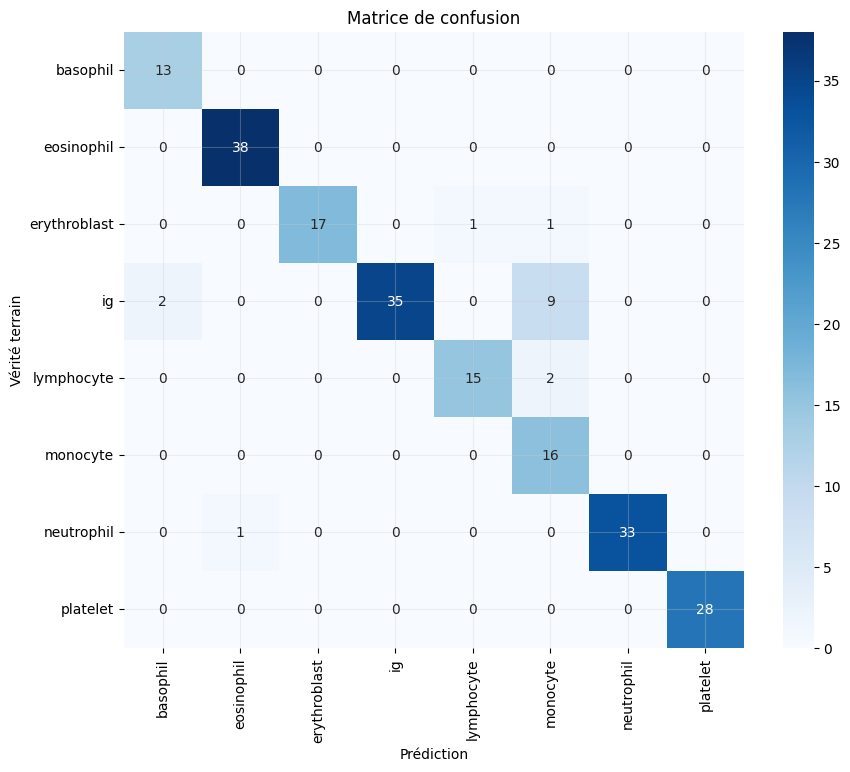

In [42]:
from sklearn.metrics import confusion_matrix, classification_report, f1_score, precision_score, recall_score

cm = confusion_matrix(all_labels, all_preds)
plt.figure(figsize=(10,8))
sns.heatmap(cm, annot=True, fmt="d", xticklabels=class_names, yticklabels=class_names, cmap="Blues")
plt.xlabel("Prédiction")
plt.ylabel("Vérité terrain")
plt.title("Matrice de confusion")
plt.show()

In [56]:
report = classification_report(all_labels, all_preds, target_names=class_names)
print(report)

              precision    recall  f1-score   support

    basophil       0.87      1.00      0.93        13
  eosinophil       0.97      1.00      0.99        38
erythroblast       1.00      0.89      0.94        19
          ig       1.00      0.76      0.86        46
  lymphocyte       0.94      0.88      0.91        17
    monocyte       0.57      1.00      0.73        16
  neutrophil       1.00      0.97      0.99        34
    platelet       1.00      1.00      1.00        28

    accuracy                           0.92       211
   macro avg       0.92      0.94      0.92       211
weighted avg       0.95      0.92      0.93       211



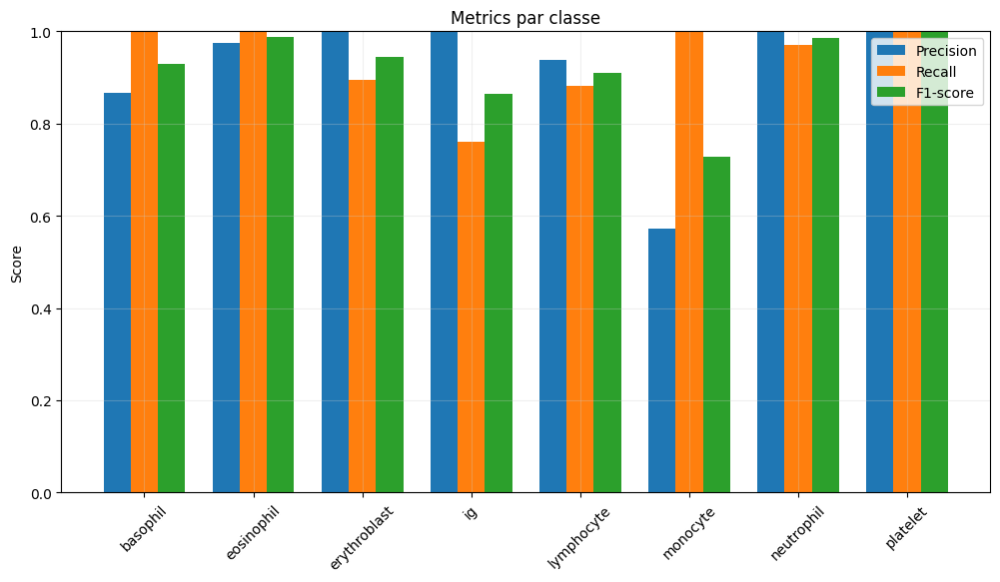

In [57]:
from sklearn.metrics import precision_recall_fscore_support

precision, recall, f1, _ = precision_recall_fscore_support(all_labels, all_preds)

x = np.arange(len(class_names))
width = 0.25

plt.figure(figsize=(12,6))
plt.bar(x - width, precision, width, label="Precision")
plt.bar(x, recall, width, label="Recall")
plt.bar(x + width, f1, width, label="F1-score")
plt.xticks(x, class_names, rotation=45)
plt.ylabel("Score")
plt.title("Metrics par classe")
plt.ylim(0,1)
plt.legend()
plt.show()


In [ ]:
BATCH_SIZE = 32
IMG_SIZE = 224
EPOCHS = 20
LR = 1e-3
# DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
if torch.backends.mps.is_available():
    DEVICE = torch.device("mps")  # GPU Apple Silicon
elif torch.cuda.is_available():
    DEVICE = torch.device("cuda") # GPU NVIDIA
else:
    DEVICE = torch.device("cpu")  # fallback CPU

print("Using device:", DEVICE)


train_transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    # transforms.RandomHorizontalFlip(),
    # transforms.RandomVerticalFlip(),
    # transforms.RandomRotation(30),
    # transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])  # normalisation ImageNet
])

val_test_transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])
])


full_dataset = datasets.ImageFolder(DATASET_PATH, transform=train_transform)
class_names = full_dataset.classes


np.random.seed(42)
subset_indices = np.random.choice(len(full_dataset), 800, replace=False)

subset_dataset = Subset(full_dataset, subset_indices)

n_train = int(0.7 * len(subset_dataset))
n_val = int(0.15 * len(subset_dataset))
n_test = len(subset_dataset) - n_train - n_val

train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(
    subset_dataset, [n_train, n_val, n_test],
    generator=torch.Generator().manual_seed(42)
)

# appliquer val/test transforms
val_dataset.dataset.transform = val_test_transform
test_dataset.dataset.transform = val_test_transform

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

# FOR CLASS IMBALANCE

labels = [y for _, y in train_dataset]
class_weights = compute_class_weight(
    class_weight="balanced",
    classes=np.arange(len(class_names)),
    y=labels
)
# weights = torch.tensor(class_weights, dtype=torch.float).to(DEVICE)
weights = torch.tensor(class_weights, dtype=torch.float32).to(DEVICE)



model = models.resnet18(weights="IMAGENET1K_V1")
num_features = model.fc.in_features
model.fc = nn.Linear(num_features, len(class_names))
model = model.to(DEVICE)

criterion = nn.CrossEntropyLoss(weight=weights)
optimizer = optim.Adam(model.parameters(), lr=LR)


best_val_acc = 0.0
for epoch in range(EPOCHS):
    print(f"Epoch {epoch+1}/{EPOCHS}")
    # ---- TRAIN ----
    model.train()
    running_loss, running_corrects = 0.0, 0
    for inputs, labels in tqdm(train_loader):
        inputs, labels = inputs.to(DEVICE), labels.to(DEVICE)

        optimizer.zero_grad()
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        loss = criterion(outputs, labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)

    epoch_loss = running_loss / len(train_dataset)
    # epoch_acc = running_corrects.double() / len(train_dataset)
    epoch_acc = running_corrects.float() / len(train_dataset)

    print(f"Train Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}")

    model.eval()
    val_corrects = 0
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(DEVICE), labels.to(DEVICE)
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            val_corrects += torch.sum(preds == labels.data)

    # val_acc = val_corrects.double() / len(val_dataset)
    val_acc = val_corrects.float() / len(val_dataset)

    print(f"Val Acc: {val_acc:.4f}")

    if val_acc > best_val_acc:
        best_val_acc = val_acc
        torch.save(model.state_dict(), "best_model.pth")
        print(">>> Best model saved!")


model.load_state_dict(torch.load("best_model.pth"))
model.eval()
test_corrects = 0
all_preds, all_labels = [], []
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(DEVICE), labels.to(DEVICE)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        test_corrects += torch.sum(preds == labels.data)
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

test_acc = test_corrects.double() / len(test_dataset)
test_acc = test_corrects.float() / len(test_dataset)

print(f"Test Acc: {test_acc:.4f}")


Using device: mps
Epoch 1/20


100%|██████████| 18/18 [00:28<00:00,  1.57s/it]


Train Loss: 0.7832 Acc: 0.7304
Val Acc: 0.6167
>>> Best model saved!
Epoch 2/20


100%|██████████| 18/18 [00:31<00:00,  1.77s/it]


Train Loss: 0.2387 Acc: 0.9232
Val Acc: 0.7583
>>> Best model saved!
Epoch 3/20


100%|██████████| 18/18 [00:29<00:00,  1.65s/it]


Train Loss: 0.1736 Acc: 0.9321
Val Acc: 0.7500
Epoch 4/20


100%|██████████| 18/18 [00:28<00:00,  1.56s/it]


Train Loss: 0.1515 Acc: 0.9429
Val Acc: 0.7167
Epoch 5/20


100%|██████████| 18/18 [00:24<00:00,  1.38s/it]


Train Loss: 0.0927 Acc: 0.9732
Val Acc: 0.6500
Epoch 6/20


100%|██████████| 18/18 [00:23<00:00,  1.29s/it]


Train Loss: 0.1356 Acc: 0.9643
Val Acc: 0.6083
Epoch 7/20


100%|██████████| 18/18 [00:25<00:00,  1.41s/it]


Train Loss: 0.2520 Acc: 0.9268
Val Acc: 0.6000
Epoch 8/20


100%|██████████| 18/18 [00:25<00:00,  1.39s/it]


Train Loss: 0.0700 Acc: 0.9839
Val Acc: 0.8583
>>> Best model saved!
Epoch 9/20


100%|██████████| 18/18 [00:28<00:00,  1.60s/it]


Train Loss: 0.0970 Acc: 0.9696
Val Acc: 0.8833
>>> Best model saved!
Epoch 10/20


100%|██████████| 18/18 [00:28<00:00,  1.58s/it]


Train Loss: 0.1394 Acc: 0.9536
Val Acc: 0.7917
Epoch 11/20


100%|██████████| 18/18 [00:25<00:00,  1.39s/it]


Train Loss: 0.0945 Acc: 0.9625
Val Acc: 0.6417
Epoch 12/20


100%|██████████| 18/18 [00:26<00:00,  1.45s/it]


Train Loss: 0.0791 Acc: 0.9768
Val Acc: 0.6250
Epoch 13/20


100%|██████████| 18/18 [00:26<00:00,  1.47s/it]


Train Loss: 0.0753 Acc: 0.9821
Val Acc: 0.8000
Epoch 14/20


100%|██████████| 18/18 [00:25<00:00,  1.40s/it]


Train Loss: 0.0235 Acc: 0.9929
Val Acc: 0.8667
Epoch 15/20


100%|██████████| 18/18 [00:25<00:00,  1.40s/it]


Train Loss: 0.0225 Acc: 0.9911
Val Acc: 0.8833
Epoch 16/20


100%|██████████| 18/18 [00:24<00:00,  1.35s/it]


Train Loss: 0.0107 Acc: 0.9964
Val Acc: 0.9167
>>> Best model saved!
Epoch 17/20


100%|██████████| 18/18 [00:29<00:00,  1.63s/it]


Train Loss: 0.0083 Acc: 0.9982
Val Acc: 0.9250
>>> Best model saved!
Epoch 18/20


100%|██████████| 18/18 [00:28<00:00,  1.60s/it]


Train Loss: 0.0073 Acc: 1.0000
Val Acc: 0.9250
Epoch 19/20


100%|██████████| 18/18 [00:23<00:00,  1.31s/it]


Train Loss: 0.0185 Acc: 0.9911
Val Acc: 0.8583
Epoch 20/20


100%|██████████| 18/18 [00:24<00:00,  1.34s/it]


Train Loss: 0.0197 Acc: 0.9982
Val Acc: 0.8583


TypeError: Cannot convert a MPS Tensor to float64 dtype as the MPS framework doesn't support float64. Please use float32 instead.

In [11]:
# test_acc = test_corrects.double() / len(test_dataset)
test_acc = test_corrects.float() / len(test_dataset)

print(f"Test Acc: {test_acc:.4f}")


Test Acc: 0.9083
